# cleanup tide gauge data
    

In [1]:
import os
from glob import glob

%matplotlib inline
import matplotlib.pyplot as plt

import numpy as np
import pandas as pd
import xarray as xr
import hvplot.pandas  # noqa
import hvplot.xarray  # noqa

import scipy.io as sio

import pynsitu as pin

/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/pyTMD/tools.py:55: UserWarning: ipyleaflet not available
  warnings.warn("ipyleaflet not available")
/Users/aponte/.miniconda3/envs/pynsitu/lib/python3.10/site-packages/pyTMD/tools.py:56: UserWarning: Some functions will throw an exception if called
  warnings.warn("Some functions will throw an exception if called")


In [2]:
## taos
root_dir = "/Users/aponte/Current_Projects/taos/campagnes/other/"

campaign="taos_other"
yaml = campaign+".yaml"

cp = pin.Campaign(os.path.join(root_dir,yaml))

# load sea level
dst = cp.load("tide_gauge_ouistreham_10min.nc")

# plot all deployments
for label, deployment, platform, sensor, meta in cp.get_all_deployments():
    print(label, platform, sensor, deployment)

d0 smile adcp d0 / start 2019-07-12 00:00:00 / end 2019-11-08 23:30:00
d1 smile adcp d1 / start 2020-02-06 00:00:00 / end 2020-05-05 05:30:00
d2 smile adcp d2 / start 2020-07-09 12:30:00 / end 2020-11-24 12:00:00
d3 smile adcp d3 / start 2021-05-20 10:15:00 / end 2021-11-16 14:15:00
d4 smile adcp d4 / start 2021-12-14 12:15:00 / end 2022-05-06 11:45:00
do0 smile hydro do0 / start 2015-06-05 10:51:21 / end 2015-11-27 09:08:10
do1 smile hydro do1 / start 2016-06-16 09:05:07 / end 2017-06-09 04:30:00
hy0 smile hydro hy0 / start 2015-07-21 12:25:21 / end 2015-11-27 08:48:09
hy1 smile hydro hy1 / start 2015-12-17 04:16:34 / end 2016-02-08 19:56:36
hy2 smile hydro hy2 / start 2016-05-12 14:08:39 / end 2016-08-17 09:23:54
hy3 smile hydro hy3 / start 2016-08-17 10:09:54 / end 2016-09-05 05:15:17
hy4 smile hydro hy4 / start 2016-09-20 11:57:31 / end 2017-06-09 05:08:05


### select constituents

This needs to be reworked

In [3]:
# option 0
#cst = ["O1", "K1", "M2", "S2"]
#cst = cst + ["M4", "MS4"]

# option 1
c = pin.tseries.load_equilibrium_constituents()
cst = [c.upper() for c in list(c.sort_values("amplitude", ascending=False)
                               .iloc[:].index
                              )
      ]
print(cst)

# option 2
import pytide
wt = pytide.WaveTable()
cst = wt.constituents()
cst = [c.upper() for c in cst]
print(cst)

# filter out some consistuents
cst = [c for c in cst if c not in ["MF", "MM", "SSA", "NU2", "MU2", "EPS2", "MSF", "LAMBDA2", "MSQM", "SA", "MTM"]]
cst = [c for c in cst if c not in ["ETA2", "SIGMA1", "RHO1", "CHI1", "PI1", "PHI1", "THETA1", "PSI1"]]
print(cst)

['M2', 'K1', 'S2', 'O1', 'P1', 'N2', 'MF', 'K2', 'MM', 'SSA', 'Q1', 'NU2', 'J1', 'MU2', 'L2', 'T2', '2N2', 'MN4', 'M4', 'MS4', 'M6', 'M3', 'EPS2', 'R2', 'S1', 'S4', 'MKS2', 'MSF', 'LAMBDA2', 'MSQM', 'SA', 'MTM', 'N4', 'M8']
['O1', 'P1', 'K1', '2N2', 'MU2', 'N2', 'NU2', 'M2', 'L2', 'T2', 'S2', 'K2', 'M4', 'S1', 'Q1', 'MM', 'MF', 'MTM', 'MSQM', 'EPS2', 'LAMBDA2', 'ETA2', '2Q1', 'SIGMA1', 'RHO1', 'M11', 'M12', 'CHI1', 'PI1', 'PHI1', 'THETA1', 'J1', 'OO1', 'M3', 'M6', 'MN4', 'MS4', 'N4', 'R2', 'R4', 'S4', 'MNS2', 'M13', 'MK4', 'SN4', 'SK4', '2MN6', '2MS6', '2MK6', 'MSN6', '2SM6', 'MSK6', 'MP1', '2SM2', 'PSI1', '2MS2', 'MKS2', '2MN2', 'MSN2', 'MO3', '2MK3', 'MK3', 'S6', 'M8', 'MSF', 'SSA', 'SA']
['O1', 'P1', 'K1', '2N2', 'N2', 'M2', 'L2', 'T2', 'S2', 'K2', 'M4', 'S1', 'Q1', '2Q1', 'M11', 'M12', 'J1', 'OO1', 'M3', 'M6', 'MN4', 'MS4', 'N4', 'R2', 'R4', 'S4', 'MNS2', 'M13', 'MK4', 'SN4', 'SK4', '2MN6', '2MS6', '2MK6', 'MSN6', '2SM6', 'MSK6', 'MP1', '2SM2', '2MS2', 'MKS2', '2MN2', 'MSN2', 'MO3'

--- 

## smile ADCP


In [5]:
dsa = cp.load("smile_adcp.nc")

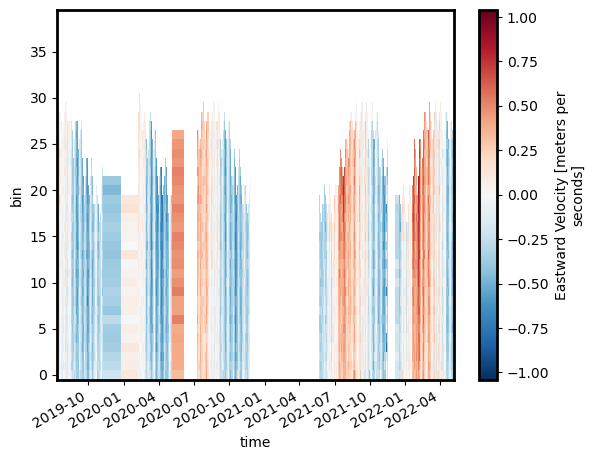

In [6]:
dsa["ve"].plot(x="time")

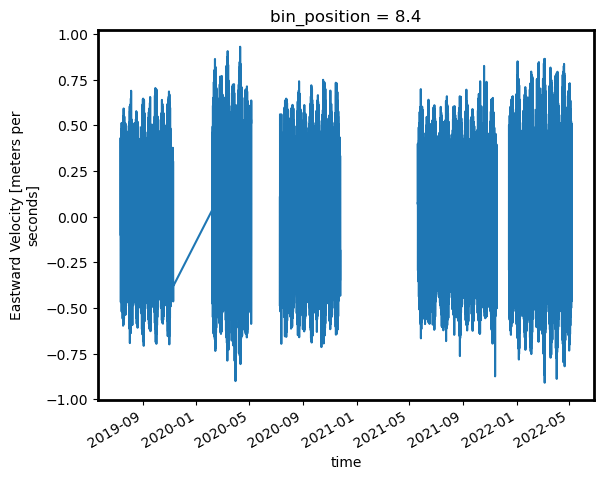

In [7]:
_ds = dsa.sel(bin=15)
_ds["ve"].plot()

df = _ds["ve"]

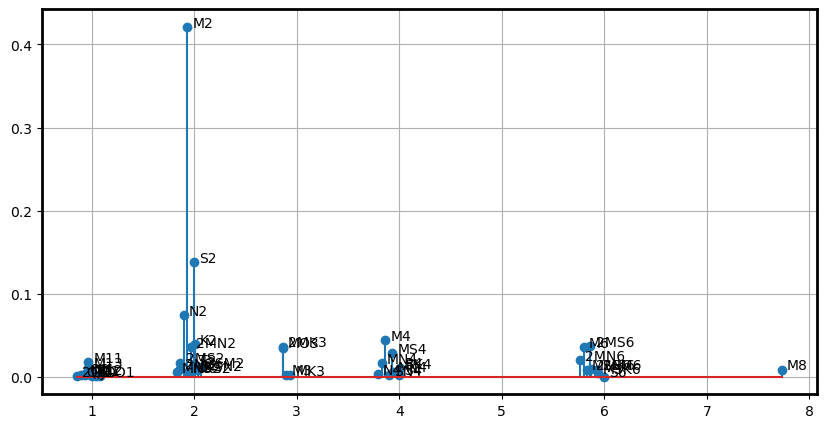

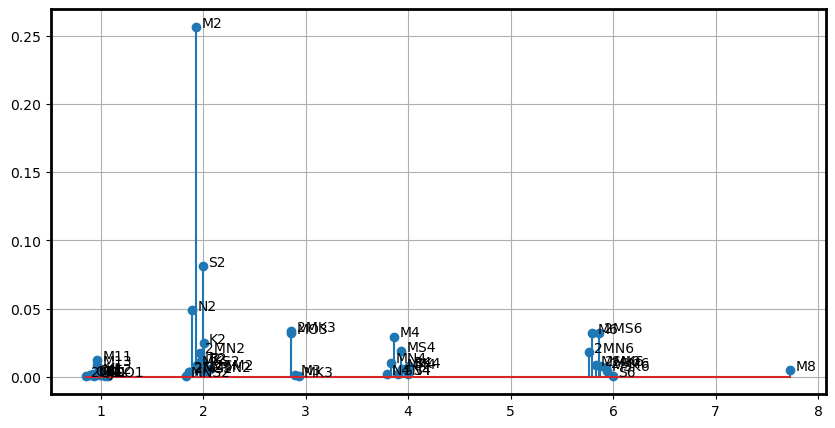

In [8]:
df = _ds.to_pandas()[["ve", "vn"]]

df.ts.tidal_analysis("ve", constituents=cst)
df.ts.tidal_analysis("vn", constituents=cst)

In [9]:
df["ve_tide"] = df.ts.tidal_predict("ve")
df["vn_tide"] = df.ts.tidal_predict("vn")

In [10]:
dsat = df.to_xarray()

### plot result of tidal prediction

In [11]:
def hvplot(dst, dsat, time=None, **kwargs):
    
    if time is not None:
        dst = dst.sel(time=slice(time[0], time[1]))
        dsat = dsat.sel(time=slice(time[0], time[1]))
    
    dkwargs = dict(grid=True, frame_width=400)
    dkwargs.update(**kwargs)
    #hover_cols=["time"], tools=['crosshair']

    p = (
        dst["sea_level"].hvplot(**dkwargs).opts(hooks=[hook])
        *dst["sea_level_tide"].hvplot(**dkwargs).opts(hooks=[hook])
    +
         dsat["ve"].hvplot(**dkwargs).opts(hooks=[hook])
         *dsat["ve_tide"].hvplot(**dkwargs).opts(hooks=[hook])
    +
        dsat["vn"].hvplot(**dkwargs).opts(hooks=[hook])
         *dsat["vn_tide"].hvplot(**dkwargs).opts(hooks=[hook])
    )
        
    return p

# make crosshair object
from bokeh.models import CrosshairTool
linked_crosshair = CrosshairTool(dimensions="both")
# make a hook to manipulate bokeh figure properties
def hook(plot, element):
    plot.state.add_tools(linked_crosshair)    


In [12]:
t0 = cp["smile"]["adcp"]["d0"].start.time + pd.Timedelta("10D")
#t1 = cp["smile"]["adcp"]["d0"].end.time
t1 = t0 + pd.Timedelta("15D")

hvplot(dst, dsat, time=(t0,t1)).cols(1)

:Layout
   .Overlay.I   :Overlay
      .Curve.I  :Curve   [time]   (sea_level)
      .Curve.II :Curve   [time]   (sea_level_tide)
   .Overlay.II  :Overlay
      .Curve.I  :Curve   [time]   (ve)
      .Curve.II :Curve   [time]   (ve_tide)
   .Overlay.III :Overlay
      .Curve.I  :Curve   [time]   (vn)
      .Curve.II :Curve   [time]   (vn_tide)

**!! Should do more serious stats about tidal predictions**

---

## smile hydrological data

In [13]:
dsh = cp.load("smile_hydrological.nc")

In [14]:
dsh["ve_tide"] = ("time", df.ts.tidal_predict("ve", time=dsh.time.values))
dsh["vn_tide"] = ("time", df.ts.tidal_predict("vn", time=dsh.time.values))
dsh["v_tide"] = np.sqrt(dsh["ve_tide"]**2 + dsh["vn_tide"]**2)
dsh["excursion"] = dsh["v_tide"].cumulative_integrate("time", datetime_unit="s")
#dsh = dsh.assign_coords(excursion=dsh["v_tide"].cumulative_integrate("time", datetime_unit="s"))

In [15]:
dsh["sea_level"] = dst["sea_level"].interp(time=dsh.time)
dsh["sea_level_tide"] = dst["sea_level_tide"].interp(time=dsh.time)

In [16]:
def hvplot(dsh, time=None, **kwargs):
    
    if time is not None:
        dsh = dsh.sel(time=slice(time[0], time[1]))
    
    dkwargs = dict(grid=True, frame_width=400)
    dkwargs.update(**kwargs)
    #hover_cols=["time"], tools=['crosshair']

    p = (
        dsh["sea_level"].hvplot(**dkwargs).opts(hooks=[hook])
        *dsh["sea_level_tide"].hvplot(**dkwargs).opts(hooks=[hook])
    +
         dsh["v_tide"].hvplot(**dkwargs).opts(hooks=[hook])
    #     dsh["ve_tide"].hvplot(**dkwargs).opts(hooks=[hook])
    #+
    #     dsh["vn_tide"].hvplot(**dkwargs).opts(hooks=[hook])
    +
        dsh["water_temperature"].hvplot(**dkwargs).opts(hooks=[hook])
    )
        
    return p


In [17]:
d = cp["smile"]["hydro"]["hy4"]

hvplot(dsh.ts.trim(d)).cols(1)

:Layout
   .Overlay.I :Overlay
      .Curve.I  :Curve   [time]   (sea_level)
      .Curve.II :Curve   [time]   (sea_level_tide)
   .Curve.I   :Curve   [time]   (v_tide)
   .Curve.II  :Curve   [time]   (water_temperature)

In [18]:
from scipy.signal import argrelmin
local_minima = argrelmin(dsh["v_tide"].values)[0]

In [19]:
cycle = (dsh.v_tide.values*0).astype(int)

V = ["excursion", "water_temperature"]
D = {v: dsh.v_tide.values*0 for v in V}

#for l in local_minima:
Ncycles = local_minima.size

for i in range(Ncycles):
    l0 = local_minima[i]
    if i<local_minima.size-1:
        l1 = local_minima[i+1]
    else:
        l1 = dsh.v_tide.values.size
    cycle[l0:l1] = i
    for v in V:
        D[v][l0:l1] = dsh[v].values[l0]

print(f"Number of cycles = {Ncycles}")

Number of cycles = 10288


In [20]:
dsh["cycle"] = ("time", cycle)

for v in V:
    dsh[v+"_start"] = ("time", D[v])
    dsh[v+"_delta"] = dsh[v] - dsh[v+"_start"]

In [21]:
#(dsh["excursion"] - dsh["excursion_start"]).rename("excursion").hvplot()

Text(0.5, 0, 'x max [m]')

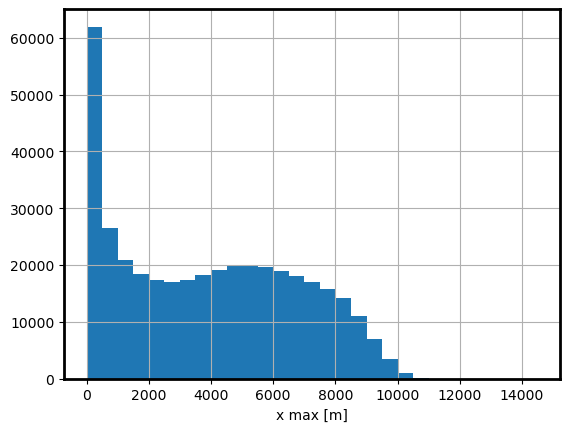

In [42]:
fig, ax = plt.subplots(1,1)
dsh["excursion_delta"].plot.hist(ax=ax, bins=np.arange(0,15e3,500))

ax.grid()
ax.set_xlabel("x max [m]")

In [23]:
v = "water_temperature"
(dsh[v+"_delta"].hvplot().opts(hooks=[hook])
+
dsh["excursion_delta"].hvplot().opts(hooks=[hook])
).cols(1)

:Layout
   .Curve.I  :Curve   [time]   (water_temperature_delta)
   .Curve.II :Curve   [time]   (excursion_delta)

Text(0.5, 1.0, 'water temperature')

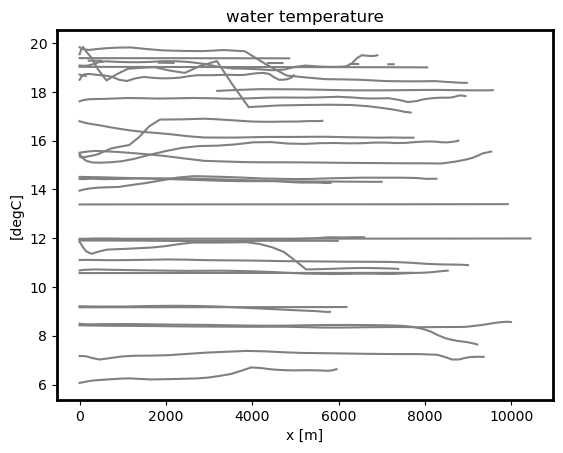

In [30]:
fig, ax = plt.subplots(1,1)

di = 100
for s in range(0, Ncycles, di):
    _ds = dsh.where(dsh.cycle==s, drop=True)
    ax.plot(_ds.excursion_delta, _ds.water_temperature, color="0.5")
    
ax.set_xlabel("x [m]")
ax.set_ylabel("[degC]")
ax.set_title("water temperature")

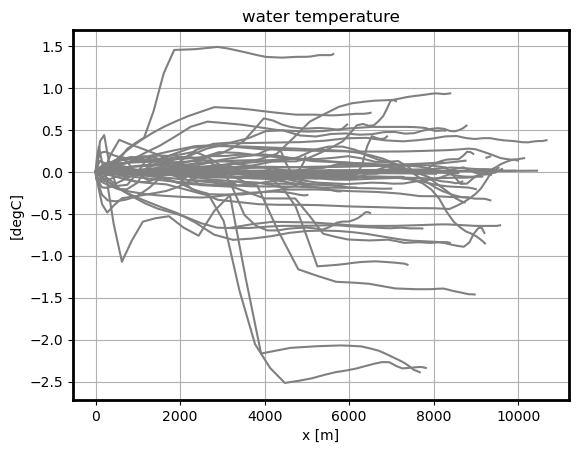

In [33]:
fig, ax = plt.subplots(1,1)

di = 50
for s in range(0, Ncycles, di):
    _ds = dsh.where(dsh.cycle==s, drop=True)
    ax.plot(_ds.excursion_delta, _ds.water_temperature_delta, color="0.5")
    
ax.set_xlabel("x [m]")
ax.set_ylabel("[degC]")
ax.set_title("water temperature")
ax.grid()

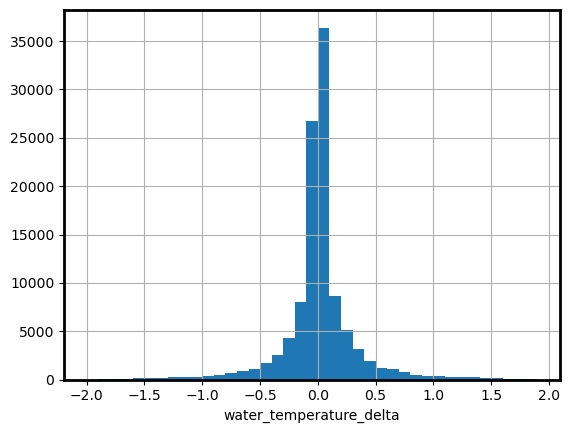

In [35]:
v = "water_temperature"

fig, ax = plt.subplots(1,1)
(dsh[v+"_delta"]).plot.hist(bins=np.arange(-2,2,.1));
#ax.set_yscale("log")
ax.grid()

### Bin by excursion and produce statistics

In [36]:
exc_bins = np.arange(0,12e3, 500)
dsh["exc_cut"] = ("time", pd.cut(dsh["excursion_delta"], exc_bins))
dsh["month"] = dsh["time"].dt.month

In [38]:
_V = ["exc_cut", "month"]+[v+"_delta" for v in V[1:]]
dsh_std = dsh[_V].groupby("exc_cut").std()

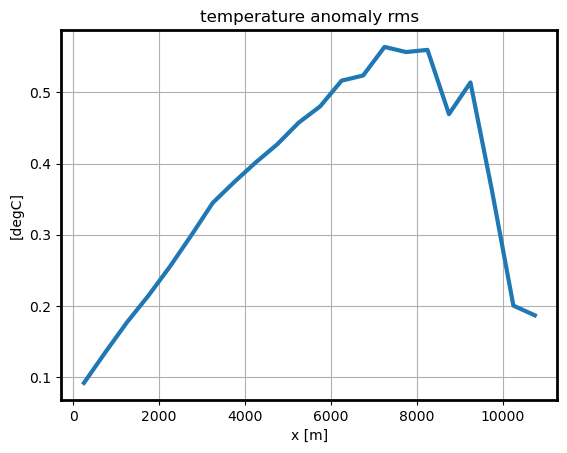

In [41]:
fig, ax = plt.subplots(1,1)
dsh_std["water_temperature_delta"].plot(ax=ax, lw=3)

s = np.arange(10e3)
#ax.plot(s, .3*)

ax.set_xlabel("x [m]")
ax.set_ylabel("[degC]")
ax.set_title("temperature anomaly rms")
ax.grid()

In [102]:
_df = dsh[_V].to_pandas()
dsh_std = _df.groupby(["exc_cut", "month"]).std().to_xarray()
dsh_count = _df.groupby(["exc_cut", "month"]).count().to_xarray()

dsh_std["count"] = dsh_count["water_temperature_delta"]

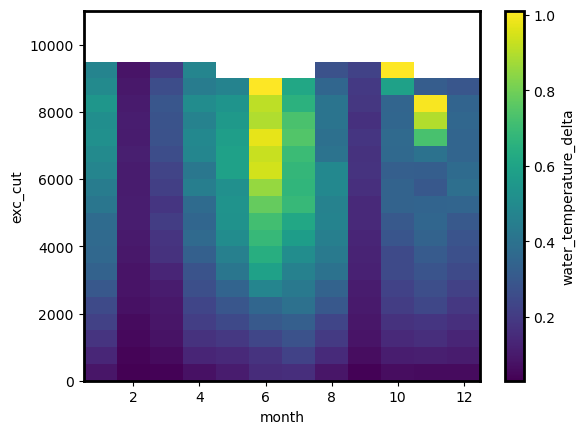

In [108]:
_dsh = dsh_std
_dsh = _dsh.where(_dsh["count"]>200)

_dsh["water_temperature_delta"].plot()

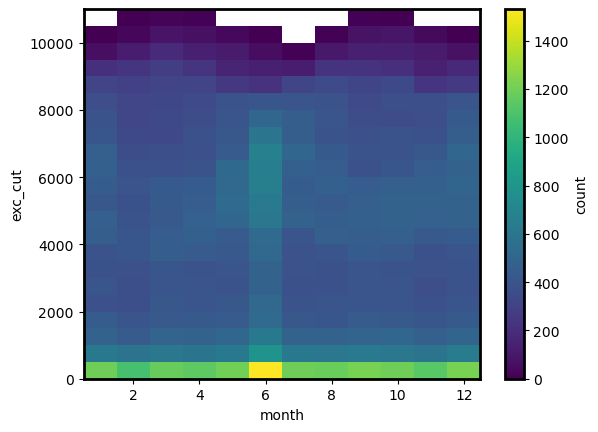

In [104]:
dsh_std["count"].plot()

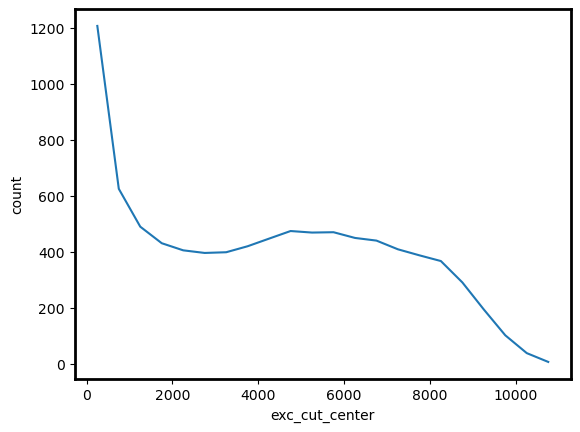

In [105]:
dsh_std["count"].mean("month").plot()

In [97]:
# lengthy
#dsh.groupby("cycle").mean()